<a href="https://colab.research.google.com/github/PodorogaElla/PforA/blob/main/Sem4HW.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Задача 1
Постройте график
Назовите график
Сделайте именование оси x и оси y
Сделайте выводы

#####1.1. Скачать следующие данные: kc-house-data 2

In [32]:
import pandas as pd
import seaborn as sns

df = pd.read_csv('kc_house_data 2.csv')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


1.2. Изучите стоимости недвижимости

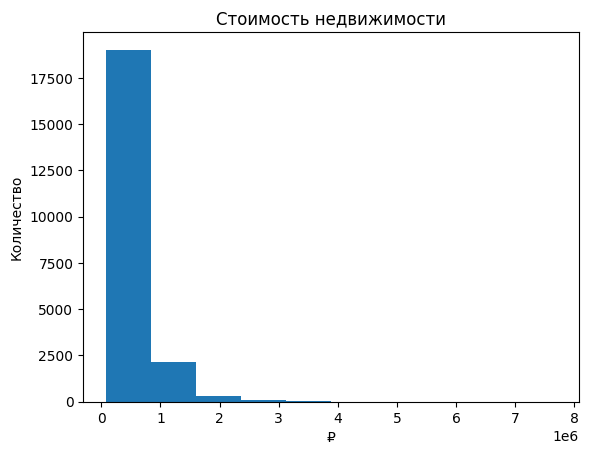

In [25]:
import matplotlib.pyplot as plt

plt.hist(df['price'])
plt.title('Стоимость недвижимости')
plt.xlabel('₽')
plt.ylabel('Количество');

1.3. Изучите распределение квадратуры жилой

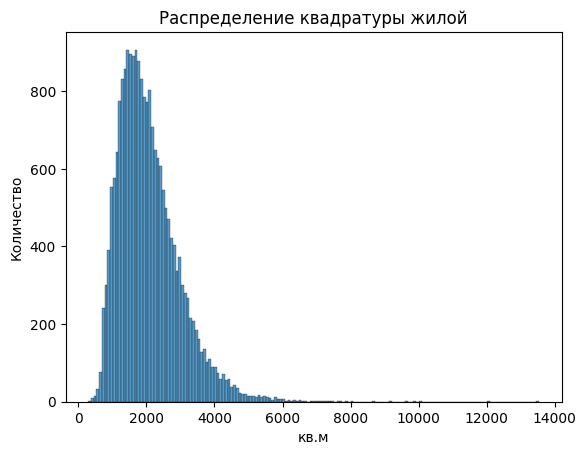

In [26]:
sns.histplot(df['sqft_living'])
plt.title('Распределение квадратуры жилой')
plt.xlabel('кв.м')
plt.ylabel('Количество');

1.4. Изучите распределение года постройки

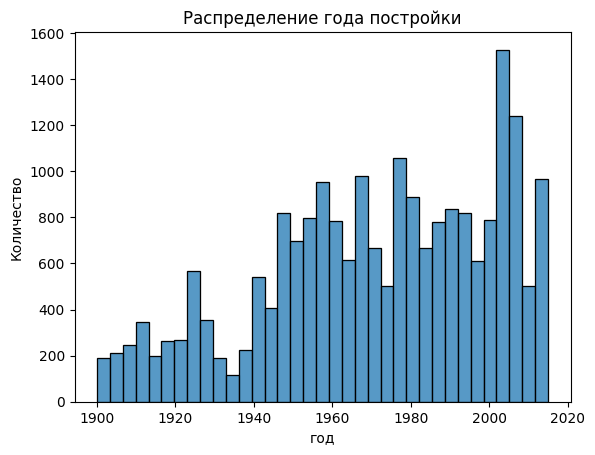

In [27]:
sns.histplot(df['yr_built'])
plt.title('Распределение года постройки')
plt.xlabel('год')
plt.ylabel('Количество');

### Задача 2
2.1. Изучите распределение домов от наличия вида на набережную.             
Постройте график.
Сделайте выводы.

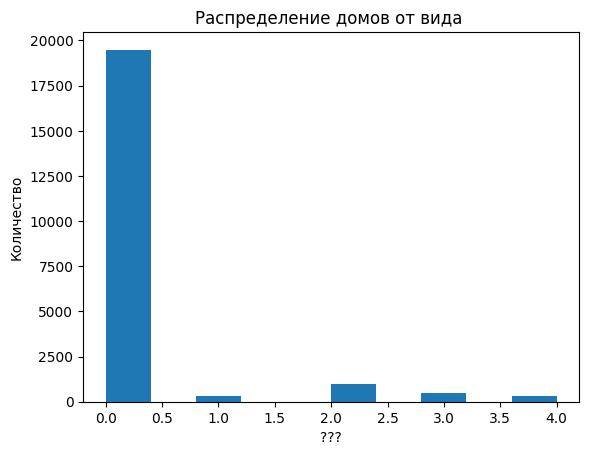

In [33]:
plt.hist(df['view'])
plt.title('Распределение домов от вида ')
plt.xlabel('???')
plt.ylabel('Количество');

2.2. Изучите распределение этажей домов

In [34]:
data = df['floors'].value_counts()
data

1.0    10680
2.0     8241
1.5     1910
3.0      613
2.5      161
3.5        8
Name: floors, dtype: int64

In [35]:
names = data.index
values = data.values

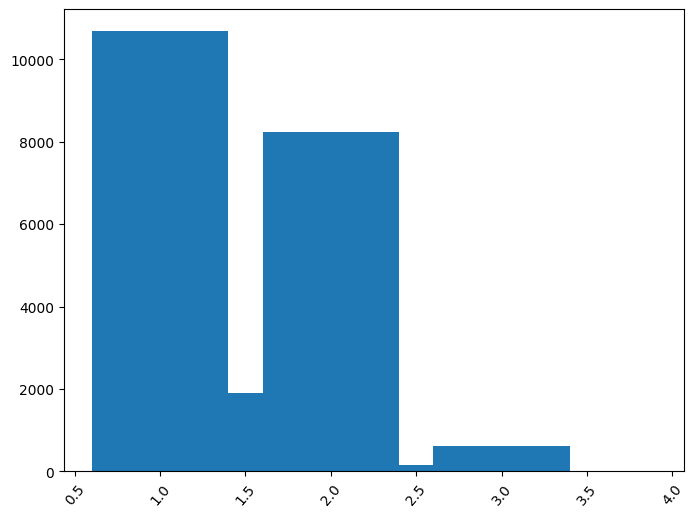

In [36]:
plt.figure(figsize=(8, 6))
plt.bar(names, values)
plt.xticks(rotation=50);

2.3. Изучите распределение состояния домов

In [37]:
data = df['grade'].value_counts()
data

7     8981
8     6068
9     2615
6     2038
10    1134
11     399
5      242
12      90
4       29
13      13
3        3
1        1
Name: grade, dtype: int64

In [38]:
names = data.index
values = data.values

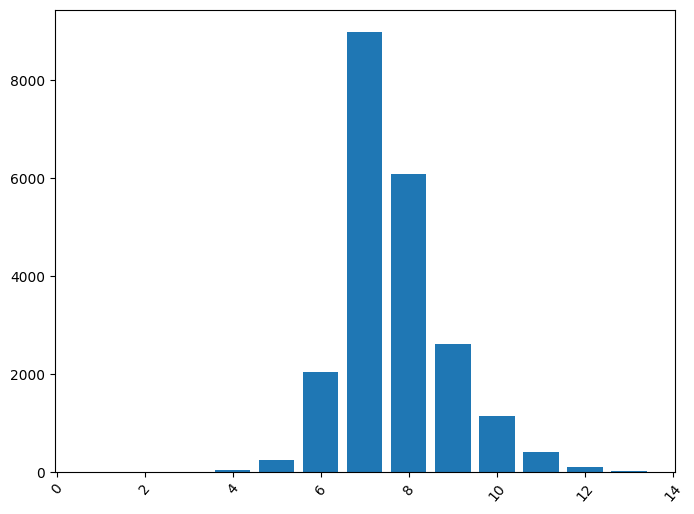

In [39]:
plt.figure(figsize=(8, 6))
plt.bar(names,values)
plt.xticks(rotation=50);

###Задача 3
Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока.  
Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.

In [ ]:
import numpy as np
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

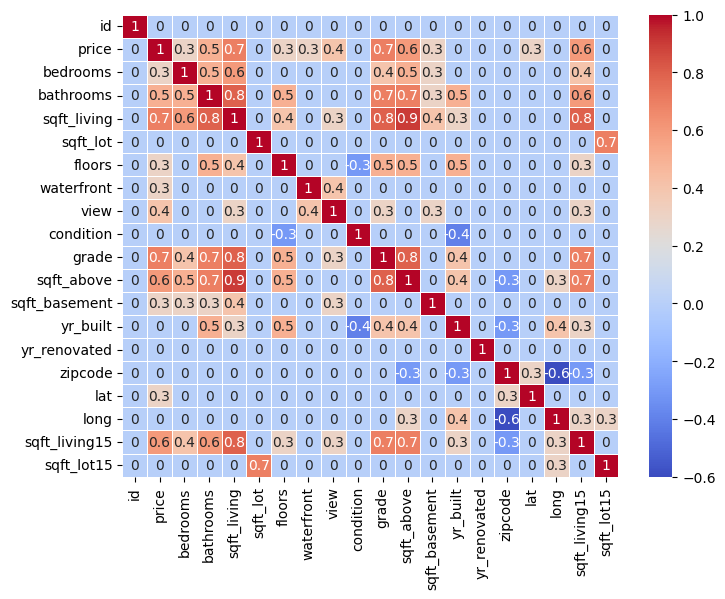

In [43]:
plt.figure(figsize=(8, 6))
sns.heatmap(corr_matrix, annot=True, linewidths=.5, cmap='coolwarm');

####Вывод:
 При рассмотрении матрицы корреляции можно заметить, что, к примеру, при увеличении жилой площади, увеличивается количество комнат, растет цена недвижимости.

In [47]:
import folium

this_map = folium.Map (perfer_canvas = True)
def plotDot (point):

    folium.CircleMarker(
        location=[point.lat, point.long],
        radis=2,
        popup=(point.price, point.floors)).add_to(this_map)

df.apply(plotDot, axis=1)
this_map.fit_bounds(this_map.get_bounds())

this_map

In [ ]:
plt.figure(figsize=(8, 6))
n_ticks = np.arange(len(data['AMD']))
offset = 0.2
w = 0.4